In [1]:
import os
# import sys
import matplotlib.pyplot as plt
import numpy as np

current_dir = os.getcwd()
# current_dir = "C:/Users/Kritika Kumari/Desktop/Project Madhu/Sem8/Mys/filtering PDBs/Alphafold/Downloads/"

filename = "Probable_no.ofnbrs_per_AA_6.5A_19-03.txt"
path_to_file = os.path.join(current_dir, filename)

In [2]:
labels=[]
means=[]
stds=[]
with open('./distri.txt') as f:
            # val = [x for x in f.readlines()]
            for line in f.readlines():
                labels.append(line.split(' ')[0])
                m1= line.split('  ')
                m2=m1[1].split(' ')
                mean=m2[0]
                std=m2[1].strip()
                means.append(float(mean))
                stds.append(float(std))

print(labels)
print(means)
print(stds)


['GLY', 'PHE', 'GLU', 'LYS', 'ARG', 'CYS', 'TYR', 'SER', 'ILE', 'LEU', 'VAL', 'ALA', 'MET', 'PRO', 'ASP', 'THR', 'ASN', 'TRP', 'GLN', 'HIS']
[5.586215703384517, 7.17038857541737, 4.82768120161409, 4.926660215380282, 5.469656485732422, 7.800162234196651, 7.102323228419762, 5.051161469761804, 7.760985592665357, 7.461417828909313, 7.43973424753432, 6.641838285369744, 6.704544544945169, 4.309613469720286, 4.7668736191072005, 5.637873205027938, 5.088994665444973, 7.0160250094054, 5.274335937703331, 5.833951085831452]
[3.0610111911261795, 2.7686003372828294, 2.462618664653486, 2.4388807036932514, 2.586715052517469, 2.958576145891852, 2.7069750169620335, 3.062893864350563, 2.9126222178328214, 2.9727854304212538, 3.1144244172226174, 3.321847757543792, 3.187856006345094, 2.7969181051784187, 2.5696065597575175, 3.034653979086171, 2.8035368204931843, 2.594498137388023, 2.6557857677941343, 2.850319445166796]


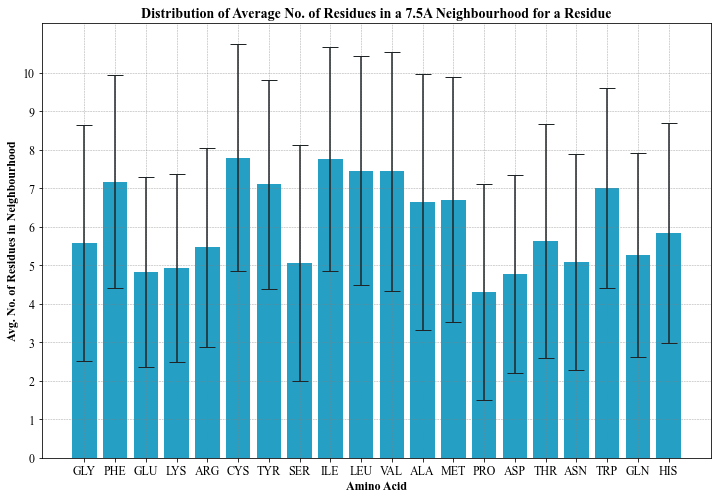

In [5]:
plt.rcParams['font.family'] = 'Times New Roman'
current_dir = os.getcwd()

fig, ax = plt.subplots(figsize=(12, 8)) # Set figure size

x_pos=np.arange(len(labels))
ax.bar(x_pos, means, yerr=stds, align='center', color='#259fc4', alpha=1, ecolor='#1f2426', capsize=8)
ax.set_xticks(x_pos)
ax.set_xticklabels(labels)
ax.set_yticks(np.arange(11))
# Set axis labels and title
ax.set_xlabel('Amino Acid', fontsize=12,fontweight='bold') # Set x-axis label with font size
ax.set_ylabel('Avg. No. of Residues in Neighbourhood', fontsize=12,fontweight='bold') # Set y-axis label with font size
ax.set_title('Distribution of Average No. of Residues in a 7.5A Neighbourhood for a Residue', fontsize=14,fontweight='bold') # Set title with font size
ax.grid(True, linestyle='--', linewidth=0.5, color='gray', alpha=0.7, zorder=0) 
# Set tick font size
# plt.yticks(np.arange(0,12800,1000))
ax.tick_params(axis='both', labelsize=12)

plt.savefig('./plot.png',dpi=400, bbox_inches='tight')
plt.show()

In [30]:
import numpy as np
import pickle
import os
import matplotlib.pyplot as plt

nrs={}
with open('./Raw_AA_wise_distribn_6.5.txt', 'r') as fi:
    for line in fi.readlines():
        if len(line)>0:
            # nrs[str(line.split(' ')[0])]=[]
            # nrs[str(line.split(' ')[0])]= float((line.strip()).split(' ')[1])
                    # Extract the amino acid code from the line
            aa_code = line.split()[0][:3]
            # print(aa_code)
                    
                    # Extract the list following the amino acid code
            lst = line.split(" ")[1:]
            k=[]
            for i in lst:
                k.append(int(i.strip("[").strip(",").strip("]\n")))
                    
            # Add the amino acid code and list to the dictionary
            nrs[aa_code] = []
            nrs[aa_code] = k

print(nrs)


{'PHE': [1, 2, 4, 6, 7, 5, 5, 3, 5, 2, 4, 5, 4, 3, 3, 5, 7, 5, 6, 6, 5, 5, 5, 7, 4, 5, 5, 4, 4, 5, 4, 6, 6, 5, 6, 6, 3, 3, 7, 4, 4, 4, 4, 5, 5, 2, 3, 5, 4, 6, 5, 4, 2, 4, 5, 7, 1, 3, 1, 2, 5, 6, 2, 5, 6, 5, 3, 3, 5, 4, 6, 3, 3, 5, 5, 4, 5, 6, 4, 5, 4, 6, 6, 6, 7, 2, 6, 5, 6, 5, 4, 7, 5, 5, 2, 6, 5, 3, 3, 2, 7, 6, 6, 1, 4, 5, 5, 5, 6, 2, 4, 4, 1, 7, 6, 7, 2, 5, 7, 5, 5, 4, 6, 2, 3, 5, 4, 5, 7, 5, 1, 6, 3, 5, 3, 7, 4, 5, 4, 5, 4, 5, 6, 8, 3, 5, 5, 5, 7, 7, 5, 4, 3, 6, 5, 3, 4, 4, 2, 4, 4, 2, 5, 2, 2, 2, 5, 3, 5, 6, 2, 3, 5, 4, 6, 4, 4, 5, 2, 7, 5, 5, 7, 6, 1, 2, 6, 4, 6, 2, 1, 6, 6, 9, 6, 3, 4, 1, 3, 2, 6, 5, 5, 6, 5, 5, 4, 3, 3, 3, 2, 2, 3, 5, 3, 1, 5, 2, 3, 4, 2, 6, 2, 8, 3, 6, 4, 5, 4, 3, 1, 1, 2, 2, 3, 1, 1, 2, 1, 1, 4, 6, 8, 6, 5, 7, 4, 4, 5, 5, 3, 3, 4, 4, 5, 6, 4, 6, 5, 1, 6, 7, 2, 3, 6, 4, 5, 2, 2, 8, 3, 6, 5, 2, 6, 3, 4, 1, 5, 7, 4, 4, 4, 4, 4, 7, 5, 3, 6, 5, 6, 2, 2, 4, 3, 6, 2, 5, 4, 4, 7, 7, 7, 1, 4, 3, 4, 2, 3, 2, 5, 6, 1, 4, 5, 2, 4, 6, 4, 6, 5, 4, 5, 1, 4, 1, 4, 5, 5, 4, 4

Done?


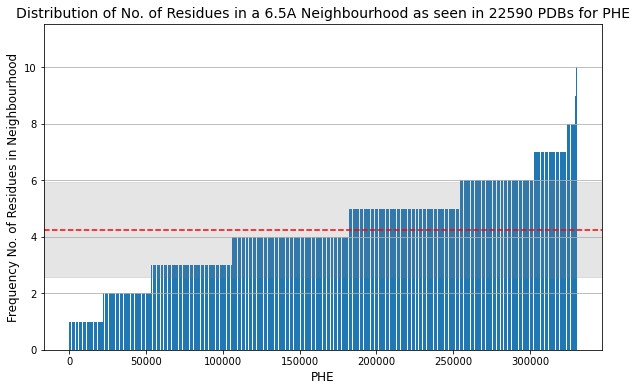

In [31]:
for key,value in nrs.items():
        y=sorted(value)
        x= np.arange(0,len(y))
        # print(key,y)
        fig, ax = plt.subplots(figsize=(10, 6))
        ax.bar(y, x)
        print("Done?")
        # Set axis labels and title
        ax.set_xlabel(str(key), fontsize=12) # Set x-axis label with font size
        ax.set_ylabel('No. of Residues in Neighbourhood', fontsize=12) # Set y-axis label with font size
        ax.set_title('Distribution of No. of Residues in a 6.5A Neighbourhood as seen in 22590 PDBs for '+str(key), fontsize=14)
        ax.grid(axis='y', which='both')
        ax.axhline(np.mean(y), color='red', linestyle='--', label='Mean '+str(np.mean(y)))
        ax.axhspan(np.mean(y)-np.std(y), np.mean(y)+np.std(y), alpha=0.2, color='gray', label='Std Dev '+str(np.std(y)))
        ax.legend(loc='upper right')
                # Set tick font size
                # plt.yticks(np.arange(0,12800,1000))
        ax.tick_params(axis='both', labelsize=10)
        plt.savefig('./plot'+str(key)+'.png',dpi=400, bbox_inches='tight')
        plt.show()
        break

TypeError: matplotlib.axes._axes.Axes.boxplot() got multiple values for keyword argument 'vert'

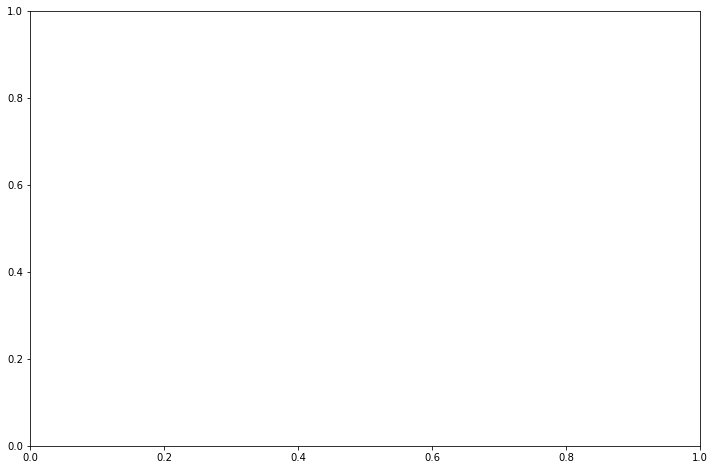

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np



fig, ax = plt.subplots(figsize=(12, 8))  # set figure size
# sns.boxplot(y=y, ax=ax, color='black', linewidth=1.5)  # set color and linewidth
# y=nrs
mean = np.mean(y)
std = np.std(y)
sns.boxplot(x=y, ax=ax, color='black', linewidth=0.5, showmeans=True, meanprops={"marker":"o","markerfacecolor":"white", "markeredgecolor":"black", "markersize":"5"}, whiskerprops={"linewidth":1.5, "color":"black"}, vert=False)
ax.axhline(np.mean(y), color='red', linestyle='--', label='Mean '+str(mean))
ax.axhspan(np.mean(y)-np.std(y), np.mean(y)+np.std(y), alpha=0.2, color='gray', label='Std Dev '+str(std))
ax.legend(loc='upper right')


# sns.swarmplot(y=y, ax=ax, color='blue', size=5, alpha=0.7)  # add swarmplot
ax.set_title('Distribution of No. of Residues in a 6.5A Neighbourhoods as seen in 22590 PDBs for PHE',fontsize=16)  # set title
ax.set_xlabel(' ',fontsize=14)  # set x-label
ax.set_ylabel('No. of Residues in Neighbourhood',fontsize=14)  # set y-label
ax.grid(axis='y', which='both')
ax.tick_params(axis='both', labelsize=12)
# ax.set_ylim([0, 12])  # set y-limits

plt.savefig('./box_plotPHE.png',dpi=400, bbox_inches='tight')
plt.show()